## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

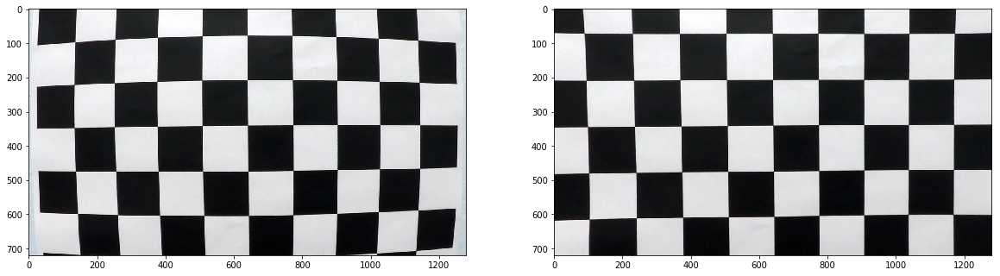

In [6]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib inline

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img_size = (img.shape[1], img.shape[0])
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        
# Given objpoints and imgpoints, compute the camera calibration
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None,None)

test_img = cv2.imread('camera_cal/calibration1.jpg')

# Checkpoint the undistorted image
undistorted_img = cv2.undistort(test_img, mtx, dist, None, mtx)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(test_img)
ax2.imshow(undistorted_img)


Looks good and now we have the distortion matrix. Let's apply it to all the test images to see the effect.

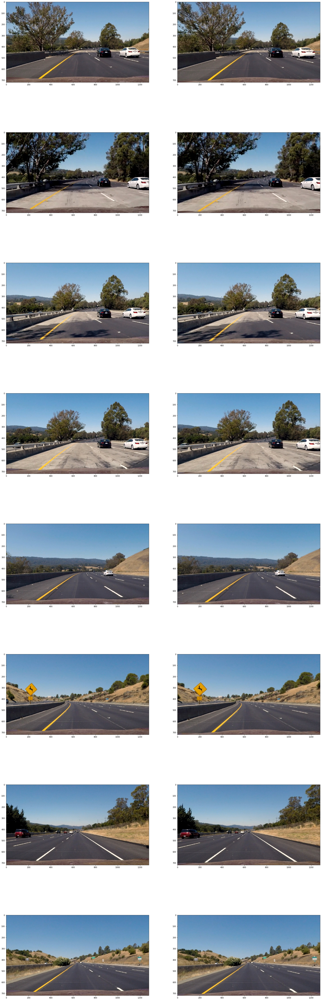

In [18]:
test_images = glob.glob('test_images/*.jpg')

f, axes = plt.subplots(len(test_images), 2, figsize=(30,100))
axis = 0
for fname in test_images:
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    axes[axis][0].imshow(img)
    axes[axis][1].imshow(undist)
    axis = axis + 1

Ok, we can definitely see the effect on some of these images, though it's subtle (the hood of the car definitely gets altered as well as some lane curvature).

### Let's create a function to handle the initial image processing to extract edges and lane-like features

Initially we're going to focus on combining the saturation channel and sobel-x direction.

In [429]:
def extract_features(img, s_thresh=(100, 255), sx_thresh=(80,120), dir_thresh=(0,np.pi/2), sobel_ksize=9): 
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
   
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0, sobel_ksize) # Take the derivative in x
    sobely = cv2.Sobel(l_channel, cv2.CV_64F, 0, 1, sobel_ksize) # Take the derivative in y
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    abs_sobely = np.absolute(sobely) # Absolute y derivative so we can get the direction field
    
    dir_grad = np.arctan2(abs_sobely, abs_sobelx)
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    binary = np.zeros_like(sxbinary)
    
    # Light pixels which meet the x-edge threshold or the saturation value threshold,
    # and the direction threshold
    binary[((scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])) |
          ((s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])) &
          ((dir_grad >= dir_thresh[0]) & (dir_grad <= dir_thresh[1]))] = 1
    
    # Stack each channel
    color_binary = np.dstack((np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    return binary

Ok, let's give it a whirl on the test images.

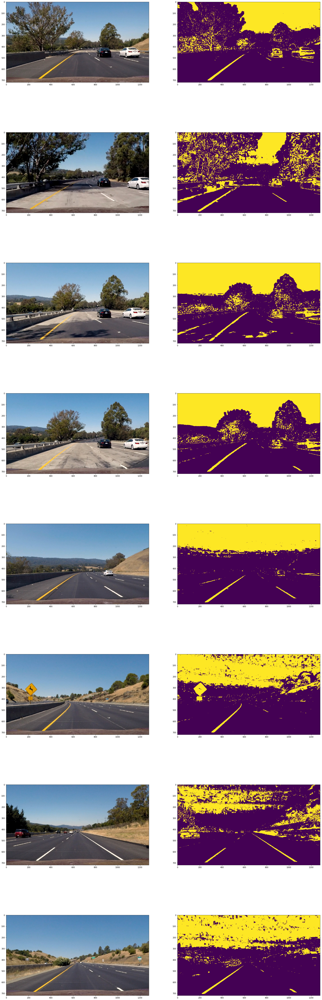

In [430]:
f, axes = plt.subplots(len(test_images), 2, figsize=(30,100))
axis = 0
for fname in test_images:
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    feature_img = extract_features(undist)
    axes[axis][0].imshow(img)
    axes[axis][1].imshow(feature_img)
    axis = axis + 1

Those are some pretty strong lane lines, so I'm confident to move forward to lane detection.

## Next step is perspective transform the images

Create a new function to give a bird's eye view of the images.

*Note as we go, I'll be adding more and more to the above loop. Later that loop will become the full image pipeline and get turned into a function.

First though, let's find some good corners.

The last image looks good and straight. Let's find some good candidate points. As the lanes are parallel they nicely describe the perspective of the flat plane of the road.

(720, 1280, 3)


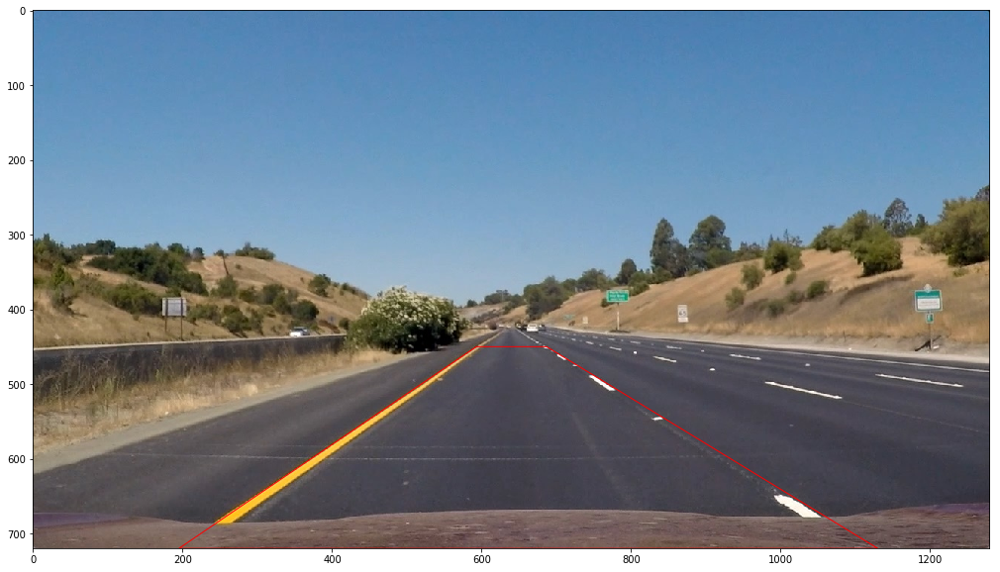

In [431]:
from matplotlib.patches import Polygon
straight_road = cv2.cvtColor(cv2.imread(test_images[len(test_images)-1]), cv2.COLOR_BGR2RGB)
f, (axis) = plt.subplots(1, 1, figsize=(20,10))
print(straight_road.shape)
corners = [ (593, 450), (687, 450), (1130, 720), (195, 720) ]
#corners = [ (520, 500), (780, 500), (1200, 660), (0, 660) ]
# Plot the corners on the image to see how well we've chosen
#for corner in corners:
#for corner in corners:
#    cv2.circle(straight_road, (corner[0], corner[1]), 8, (255, 0, 0), 3)
#    cv2.circle(straight_road, (corner[0], corner[1] + 100), 4, (255, 0, 0), 3)
srcPoly = Polygon(corners, edgecolor='r', facecolor='none')
axis.imshow(straight_road)
axis.add_patch(srcPoly)

Those look good, let's see how well they work.

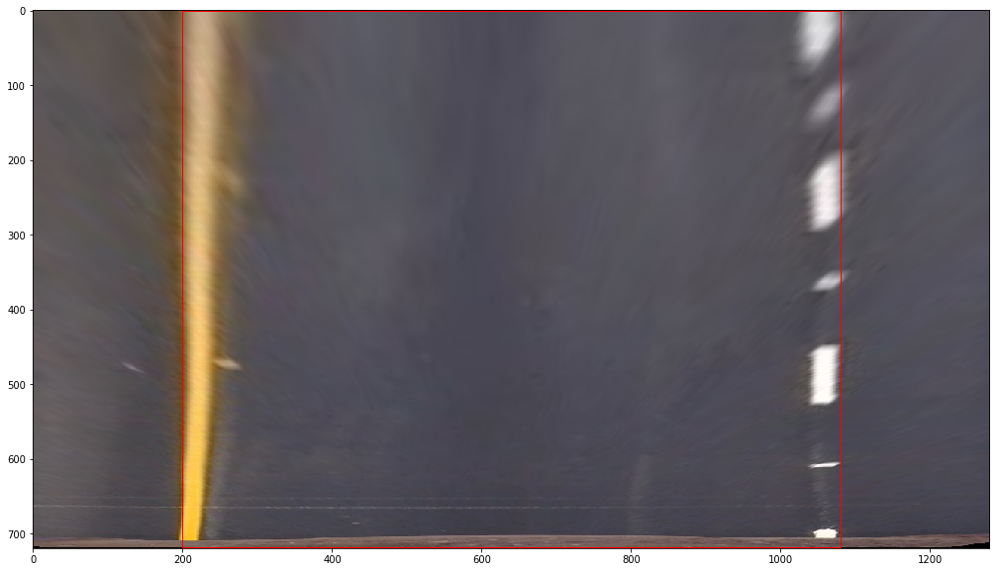

In [432]:
img_shape = straight_road.shape
img_size = (img_shape[1], img_shape[0])
src = np.float32([corners[0], corners[1], corners[2], corners[3]])
dst = np.float32([[200,0], [img_size[0] - 200, 0], [img_size[0] - 200, img_size[1] - 1], [200, img_size[1] - 1]])

M = cv2.getPerspectiveTransform(src, dst)
top_down = cv2.warpPerspective(straight_road, M, img_size, flags=cv2.INTER_LINEAR)
f, (axis) = plt.subplots(1, 1, figsize=(20,10))
dstPoly = Polygon(dst, edgecolor='r', facecolor='none')
axis.imshow(top_down)
axis.add_patch(dstPoly)


Ok, those look pretty straight. I mostly determined the best corners through trial and error, but since we now these lines are parallel in 3D world space, now that they are straight post-transform we can be confident that the transform is correct.

So let's make the function!

In [433]:
def perspective_correction(img):
    img_shape = img.shape
    img_size = (img_shape[1], img_shape[0])
    corners = [ (593, 450), (687, 450), (1130, 720), (195, 720) ]
    src = np.float32([corners[0], corners[1], corners[2], corners[3]])
    dst = np.float32([[200,0], [img_size[0] - 200, 0], [img_size[0] - 200, img_size[1] - 1], [200, img_size[1] - 1]])

    M = cv2.getPerspectiveTransform(src, dst)
    top_down = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return top_down

Let's apply that to the binary images.

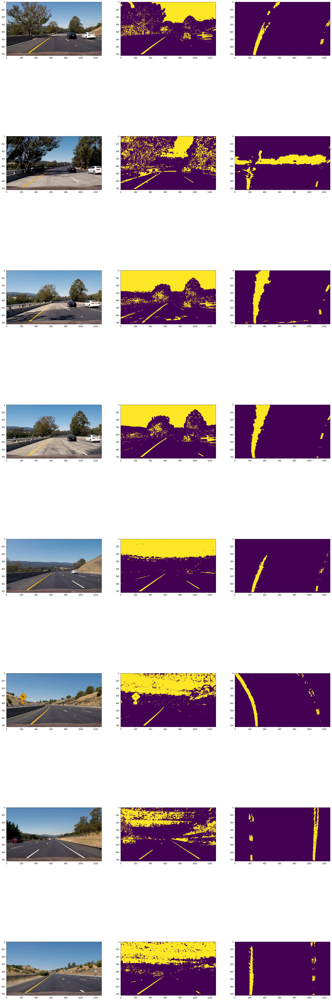

In [434]:
f, axes = plt.subplots(len(test_images), 3, figsize=(30,100))
axis = 0
for fname in test_images:
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    feature_img = extract_features(undist)
    top_down = perspective_correction(feature_img)
    axes[axis][0].imshow(img)
    axes[axis][1].imshow(feature_img)
    axes[axis][2].imshow(top_down)
    axis = axis + 1

Not too bad, so let's write the next function in the pipeline: the lane detector. We're going to include a `Line` class as suggested in the hints to keep track of state frame-to-frame.

In [483]:
# Define a class to receive the characteristics of each line detection and keep track of
# running statistics over time for averaging
class Line():
    def __init__(self, laneID):
        
        # was the line detected in the last iteration?
        self.detected = False 
        if (laneID != 'left') and (laneID != 'right'):
            raise Exception("Lane ID must be \'left\' or \'right\'")
        self.ID = laneID
      
    # Use the below for determining the current displayed lane
    # position and curvature
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
       
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
       
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
       
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
       
        #radius of curvature of the line in some units (averaged)
        self.radius_of_curvature = None 
       
        #distance in meters of vehicle center from the line (result of averaged pos)
        self.line_base_pos = None
      
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
      
        #x values for detected line pixels (current)
        self.allx = None  
      
        #y values for detected line pixels (current)
        self.ally = None

In [551]:
class DetectionHyperParams():
    ### Convenience class to store hyperparameters for lane search in one place
    def __init__(self, num_windows = 9, window_margin = 100, window_minpix = 8, poly_margin = 100, 
                 poly_minpix = 3000):
        self.num_windows = num_windows
        self.window_margin = window_margin
        self.window_minpix = window_minpix
        self.poly_margin = poly_margin
        self.poly_minpix = poly_minpix

### Lane Detector class manages all detection and statistics about lanes. This is designed
### to be easily extensible to finding more than just the immediate lane lines (i.e. if 
### you wanted to track additional lanes for chaning lanes, etc.)
class LaneDetector():
    
    # Init with a seed image to find shapes and basic starting points 
    # for window-marching lane search. This saves having to do this
    # over and over. Relies on the assumption that all images are the
    # same format, which is a safe one.
    def __init__(self, seed_image, search_hyperparams, lanes):
        self.image_dimensions = seed_image.shape
        self.image_midpoint = np.int(self.image_dimensions[1]//2)
        self.hyperparams = search_hyperparams
        self.lanes = lanes

    def search_via_windows(self, img, lane):

        # Take a histogram of the bottom half of the image
        histogram = np.sum(img[self.image_dimensions[0]//2:,:], axis=0)
        # Create an output image to draw on and visualize the result
        out_img = np.dstack((img * 255, img * 255, img * 255))

        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        if lane.ID == 'left':
            base = np.argmax(histogram[:self.image_midpoint])
        elif lane.ID == 'right':
            base = np.argmax(histogram[self.image_midpoint:]) + self.image_midpoint
        else:
            raise Excepetion('Invalid lane ID provided to search_via_windows()')

        # Set height of windows - based on nwindows above and image shape
        window_height = np.int(self.image_dimensions[0]//self.hyperparams.num_windows)

        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = img.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        
        # Current position to be updated later for each window in nwindows
        x_current = base

        # Create empty list to receive lane pixel indices
        lane_inds = []

        # Step through the windows one by one
        for window in range(self.hyperparams.num_windows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = img.shape[0] - (window + 1) * window_height
            win_y_high = img.shape[0] - window * window_height
            win_x_low = x_current - self.hyperparams.window_margin  
            win_x_high = x_current + self.hyperparams.window_margin  
          
            # Draw the windows on the visualization image
            cv2.rectangle(out_img, (win_x_low, win_y_low), (win_x_high, win_y_high), (0,255,0), 2) 
         
            ### Identify the nonzero pixels in x and y within the window ###
            good_inds = ((nonzerox < win_x_high) & (nonzerox >= win_x_low) &
                (nonzeroy < win_y_high) & (nonzeroy >= win_y_low)).nonzero()[0]
        
            # Append these indices to the lists
            lane_inds.append(good_inds)

            ### If you found > minpix pixels, recenter next window ###
            ### (`right` or `leftx_current`) on their mean position ###
            if (len(good_inds)) > self.hyperparams.window_minpix:
                x_current = int(np.mean(nonzerox[good_inds]))
                lane.detected = True
           
        # Concatenate the arrays of indices (previously was a list of lists of pixels)
        try:
            lane_inds = np.concatenate(lane_inds)
        except ValueError:
            # Avoids an error if the above is not implemented fully
            pass

        # Extract left and right line pixel positions
        lane.allx = nonzerox[lane_inds]
        lane.ally = nonzeroy[lane_inds] 
        return out_img

    def search_via_prior_fit(self, img, lane):

        fit = lane.current_fit

        # Grab activated pixels
        nonzero = img.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])

        ### Set the area of search based on activated x-values ###
        ### within the +/- margin of our polynomial function ###
        x_fit = (fit[0]*nonzeroy**2 + fit[1]*nonzeroy + fit[2])
        lane_inds = ((nonzerox >= (x_fit - self.hyperparams.poly_margin)) & 
                     (nonzerox < (x_fit + self.hyperparams.poly_margin))).nonzero()[0]

        # If the lane is low quality, return nothing found, signalling to try
        # another more intensive method. Either the lane moved too much frame-to-frame
        # or the image is degraded and we can't find it. Window marching may work better.
        if (len(lane_inds) < self.hyperparams.poly_minpix):
            print("Escaping due to low quality lane match")
            return None

        # Again, extract left and right line pixel positions
        lane.allx = nonzerox[lane_inds]
        lane.ally = nonzeroy[lane_inds] 

        # Fit new polynomials
        fitx, ploty = self.fit_poly(lane)

        ## Visualization ##
        # Create an image to draw on and an image to show the selection window
        out_img = np.dstack((img, img, img))*255
        window_img = np.zeros_like(out_img)

        # Color in left and right line pixels
        out_img[nonzeroy[lane_inds], nonzerox[lane_inds]] = [255, 0, 0]

        # Generate a polygon to illustrate the search window area
        # And recast the x and y points into usable format for cv2.fillPoly()
        line_window1 = np.array([np.transpose(np.vstack([fitx - self.hyperparams.poly_margin, ploty]))])
        line_window2 = np.array([np.flipud(np.transpose(np.vstack([fitx + self.hyperparams.poly_margin, 
                                  ploty])))])
        line_pts = np.hstack((line_window1, line_window2))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(window_img, np.int_([line_pts]), (0,255, 0))
        result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

        line_center = np.array([np.transpose(np.vstack([fitx, ploty]))])
        cv2.polylines(result, np.int_([line_center]), False, (255, 0, 0), 3)
        return result

    def fit_poly(self, lane):
        x = lane.allx
        y = lane.ally
     
        fit = np.polyfit(y, x, 2)

        # Generate x and y values for plotting
        ploty = np.linspace(0, self.image_dimensions[0]-1, self.image_dimensions[0])
        fitx = fit[0]*ploty**2 + fit[1]*ploty + fit[2]

        lane.current_fit = fit
        return fitx, ploty

    def detect(self, img):
        out_images = [None] * len(self.lanes)
        lane_idx = 0
        for lane in self.lanes:
            print("working lane " + str(lane.ID))
            if lane.detected is False:
                out_images[lane_idx] = self.search_via_windows(img, lane)
                self.fit_poly(lane)
            else:
                out_img = self.search_via_prior_fit(img, lane)
                if out_img is None:
                    out_images[lane_idx] = self.search_via_windows(img, lane)
                    self.fit_poly(lane)
                else:
                    out_images[lane_idx] = out_img
            lane_idx = (lane_idx + 1) % len(self.lanes) 
        return cv2.addWeighted(out_images[0], 1, out_images[1], 1, 0)

working lane left
working lane right
working lane left
working lane right
working lane left
working lane right
working lane left
working lane right
working lane left
working lane right
working lane left
working lane right
Escaping due to low quality lane match
working lane left
working lane right
working lane left
working lane right


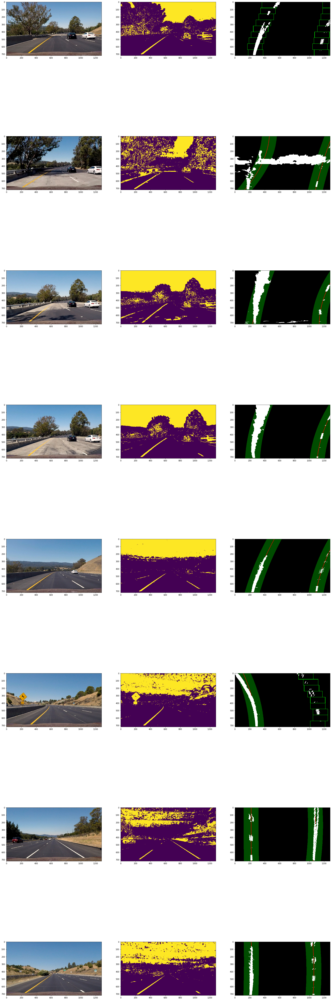

In [552]:
left = Line('left')
right = Line('right')
params = DetectionHyperParams()
seed_image = cv2.imread(test_images[0])
detector = LaneDetector(seed_image, params, [left, right])
f, axes = plt.subplots(len(test_images), 3, figsize=(30,100))
axis = 0
for fname in test_images:
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    feature_img = extract_features(undist)
    top_down = perspective_correction(feature_img)
    detection_img = detector.detect(top_down)
    axes[axis][0].imshow(img)
    axes[axis][1].imshow(feature_img)
    axes[axis][2].imshow(detection_img)
    axis = axis + 1
    
# Pull "draw lane" out so we can just plot the fits